# Statistics with Julia from the ground up - 2022

#### A [JuliaCon 2022](https://juliacon.org/2022/) workshop by [Yoni Nazarathy](https://yoninazarathy.com/)

The 2022 workshop is in Hebrew (עברית). There was a similar 2021 workshop in English, it is available via [YouTube](https://www.youtube.com/watch?v=IlPoU5Yr2QI). An English recording of the 2022 may be created later on.

Many of the code examples for this workshop are adapted from [Statistics with Julia:
Fundamentals for Data Science, Machine Learning and Artificial Intelligence by Yoni Nazarathy and Hayden Klok](https://statisticswithjulia.org/).  

This notebook is available in [this GitHub repo](https://github.com/yoninazarathy/StatisticsWithJuliaFromTheGroundUp-2022)

Also related (and recommended in 2022 JuliaCon): 
* [Introduction to Julia](https://live.juliacon.org/talk/WLNWBV) by Jose Storopoli - see also the nice book (online and freely avaiable) [Julia Data Science](https://juliadatascience.io/)
* [https://live.juliacon.org/talk/Q7WJ9F](https://live.juliacon.org/talk/Q7WJ9F) by Anthony Blaom, Samuel
* [Statistics symposium](https://live.juliacon.org/talk/7JNQCM)
* [Interactive data visualizations with Makie.jl](https://live.juliacon.org/talk/FBLWD3) by Simon Danisch, and Julius Krumbiegel
* [Julia REPL Mastery Workshop](https://live.juliacon.org/talk/PFUHDL) by Miguel Raz Guzmán Macedo
* [A Complete Guide to Efficient Transformations of data frames](https://live.juliacon.org/talk/83E8CW) by Bogumił Kamiński
* [Julia in VS Code - What's New](https://live.juliacon.org/talk/JPYJS8) by David Anthoff, Sebastian Pfitzner
* [The State of Julia in 2022
](https://live.juliacon.org/talk/SSUNVP) by Viral B Shah.
* Dozens of other very exciting talks...

Also from JuliaCon 2021: 
* [Dataframes tutorial](https://github.com/bkamins/JuliaCon2021-DataFrames-Tutorial) or [here](https://pretalx.com/juliacon2021/talk/FXZXMB/) by Bogumił Kamiński.
* [Introduction to Bayesian Data Analysis](https://pretalx.com/juliacon2021/talk/J7BFBM/) by Kusti Skytén.

<a id='home'></a>
# Table of Contents

1. [Why Julia?](#why-julia)
1. [What do you `mean`?](#what-do-you-mean)
1. [Something `rand`.](#something-rand)
1. [Do you still miss R? So Just `RCall`.](#just-rcall)
1. [Some `Plots`.](#some-plots)
1. [Your favorite `Distribution`.](#favorite-distribution)
1. [We love `DataFrames`.](#love-dataframes)
1. [Gotta have some basic inference.](#inference)
1. [Linear models at our core.](#linear-models)
1. [Basic Machine learning.](#basic-ml)


---
## Before we start

In [1]:
1+1 #See your Julia Kernal is running. Hit [SHIFT] + [ENTER] to run a jupyter cell

2

In [2]:
versioninfo()

Julia Version 1.7.3
Commit 742b9abb4d (2022-05-06 12:58 UTC)
Platform Info:
  OS: macOS (x86_64-apple-darwin21.4.0)
  CPU: Intel(R) Core(TM) i7-9750H CPU @ 2.60GHz
  WORD_SIZE: 64
  LIBM: libopenlibm
  LLVM: libLLVM-12.0.1 (ORCJIT, skylake)


The tutorial was developed and tested under Julia 1.7.3. It is best to run it with the `Project.toml` and `Manifest.toml` files present in the working directory of the notebook. It also uses the following data files: 

In [3]:
pwd()

"/Users/uqjnazar/git/mine/StatisticsWithJuliaFromTheGroundUp-2022"

In [4]:
readdir("./data")

8-element Vector{String}:
 "L1L2data.csv"
 "fertilizer.csv"
 "machine1.csv"
 "machine2.csv"
 "machine3.csv"
 "purchaseData.csv"
 "temperatures.csv"
 "weightHeight.csv"

You will find all these files and this notebook in the [Github repo for this workshop](https://github.com/yoninazarathy/StatisticsWithJuliaFromTheGroundUp-2022). You can either "clone" the repo or download a zip file.

We use a [Jupyter Notebook](https://jupyter.org/). Here is a [quick reference sheet](https://www.edureka.co/blog/wp-content/uploads/2018/10/Jupyter_Notebook_CheatSheet_Edureka.pdf) - it is Python oriented but useful for Julia as well. Actually, many other Jupyter web reserouces focus on Python and not Julia - yet are useful for Julia. BTW the "J" in "Jupyter" is for "Julia".

Load the packages we will use:

In [5]:
using Pkg
Pkg.activate(".")
Pkg.instantiate()

  Activating project at `~/git/mine/StatisticsWithJuliaFromTheGroundUp-2022`


In [6]:
Pkg.status()

      Status `~/git/mine/StatisticsWithJuliaFromTheGroundUp-2022/Project.toml`
  [336ed68f] CSV v0.10.4
  [aaaa29a8] Clustering v0.14.2
  [861a8166] Combinatorics v1.0.2
  [a93c6f00] DataFrames v1.3.4
  [31c24e10] Distributions v0.25.65
  [38e38edf] GLM v1.8.0
  [09f84164] HypothesisTests v0.10.10
  [5ab0869b] KernelDensity v0.6.4
  [b964fa9f] LaTeXStrings v1.3.0
  [b4fcebef] Lasso v0.6.3
  [eb30cadb] MLDatasets v0.7.4
  [442fdcdd] Measures v0.3.1
  [6f286f6a] MultivariateStats v0.9.1
  [91a5bcdd] Plots v1.31.3
  [6f49c342] RCall v0.13.13
  [ce6b1742] RDatasets v0.7.7
  [f2b01f46] Roots v2.0.2
  [276daf66] SpecialFunctions v2.1.7
  [2913bbd2] StatsBase v0.33.19
  [f3b207a7] StatsPlots v0.15.0


In [7]:
using Random, Statistics, LinearAlgebra, Dates #Shipped with Julia
using Distributions, StatsBase #Core statistics
using CSV, DataFrames #Basic Data
using Plots, StatsPlots, LaTeXStrings, Measures #Plotting and Output
using HypothesisTests, KernelDensity, GLM, Lasso, Clustering, MultivariateStats #Statistical/ML methods
using Combinatorics, SpecialFunctions, Roots #Mathematical misc.
using RDatasets, MLDatasets #Example datasets
#uncomment if using R:  using RCall #Interface with R

In [8]:
# We run this before many examples for reproducibility
fix_seed!() = Random.seed!(0)

fix_seed! (generic function with 1 method)

<a id='why-julia'></a>

---

# Why Julia?
[home](#home)

![Julia Curve](img/julia_curve.png)

### Some ways to run Julia

* REPL
    - As an application
    - Out of your shell 
    - As part of an IDE
* Jupyter (IJulia)
    - In your web browser
    - Jupyter Lab
* Google collab
* Pluto
* Visual Studio Code
* Legacy: Atom (Juno)
* JuliaHub
* In RMarkdown with IJulia (e.g. in R studio)
* ... 

### Key resources (My favorites)

* Main Julia Page: https://julialang.org/
* Docs: https://docs.julialang.org/
* Julia Express: https://github.com/bkamins/The-Julia-Express 
* Think Julia: https://www.oreilly.com/library/view/think-julia/9781492045021/
* Julia Data Science: https://juliadatascience.io/
* Statistics with Julia: https://statisticswithjulia.org/
* MIT Course, computational thinking: https://computationalthinking.mit.edu/Spring21/ 
* A University of Queensland Course: https://courses.smp.uq.edu.au/MATH2504/
* Statistics with Julia: https://statisticswithjulia.org/ (use image gallary) 
* Package documentation: Searching for the package, e.g. `Plots.jl`, typically gets you to GitHub. From there find the docs.
* Julia Discourse: https://discourse.julialang.org/
* Julia Slack: https://julialang.org/slack/ 
* Your local Julia "club": E.g. in my area: https://www.meetup.com/en-AU/brisbane-julia-language-meetup/ 
* YouTube...


<a id='what-do-you-mean'></a>

---

# What do you `mean`?
[home](#home)

In [9]:
fix_seed!()
data = rand(Normal(),5)

5-element Vector{Float64}:
  0.942970533446119
  0.13392275765318448
  1.5250689085124804
  0.12390123120559722
 -1.205772284259936

In [10]:
n = length(data)

5

In [11]:
sum(data)/n

0.30401822931148903

In [12]:
+(data...)/n

0.30401822931148903

In [13]:
? +

search: +



```
+(x, y...)
```

Addition operator. `x+y+z+...` calls this function with all arguments, i.e. `+(x, y, z, ...)`.

# Examples

```jldoctest
julia> 1 + 20 + 4
25

julia> +(1, 20, 4)
25
```

---

```
dt::Date + t::Time -> DateTime
```

The addition of a `Date` with a `Time` produces a `DateTime`. The hour, minute, second, and millisecond parts of the `Time` are used along with the year, month, and day of the `Date` to create the new `DateTime`. Non-zero microseconds or nanoseconds in the `Time` type will result in an `InexactError` being thrown.


In [14]:
"""
This is a function that takes in data and returns its sum.
"""
function my_sum(data)
    s = 0.0
    for d in data
        s += d
    end
    return s
end

my_sum

In [15]:
? my_sum

search: my_sum



This is a function that takes in data and returns its sum.


In [16]:
my_sum(data)/length(data)

0.30401822931148903

In [17]:
mean(data)

0.30401822931148903

In [18]:
data'*ones(n)/n

0.30401822931148903

In [19]:
dot(data,ones(n))/n

0.30401822931148903

In [20]:
? dot

search: dot dotplot dotplot! @__dot__ stdout DEPOT_PATH groupeddotplot



```
dot(x, y)
x ⋅ y
```

Compute the dot product between two vectors. For complex vectors, the first vector is conjugated.

`dot` also works on arbitrary iterable objects, including arrays of any dimension, as long as `dot` is defined on the elements.

`dot` is semantically equivalent to `sum(dot(vx,vy) for (vx,vy) in zip(x, y))`, with the added restriction that the arguments must have equal lengths.

`x ⋅ y` (where `⋅` can be typed by tab-completing `\cdot` in the REPL) is a synonym for `dot(x, y)`.

# Examples

```jldoctest
julia> dot([1; 1], [2; 3])
5

julia> dot([im; im], [1; 1])
0 - 2im

julia> dot(1:5, 2:6)
70

julia> x = fill(2., (5,5));

julia> y = fill(3., (5,5));

julia> dot(x, y)
150.0
```

---

```
dot(x, A, y)
```

Compute the generalized dot product `dot(x, A*y)` between two vectors `x` and `y`, without storing the intermediate result of `A*y`. As for the two-argument [`dot(_,_)`](@ref), this acts recursively. Moreover, for complex vectors, the first vector is conjugated.

!!! compat "Julia 1.4"
    Three-argument `dot` requires at least Julia 1.4.


# Examples

```jldoctest
julia> dot([1; 1], [1 2; 3 4], [2; 3])
26

julia> dot(1:5, reshape(1:25, 5, 5), 2:6)
4850

julia> ⋅(1:5, reshape(1:25, 5, 5), 2:6) == dot(1:5, reshape(1:25, 5, 5), 2:6)
true
```


#### Doing it a little differently with the "running mean" formula

$$
\overline{X}_i = \frac{1}{i} X_i + \frac{i-1}{i} \overline{X}_{i-1}.
$$

In [21]:
mn = 0
for i in 1:length(data)
    global mn = (1/i)*data[i] + (i-1)/i*mn
end
mn

0.3040182293114889

In [22]:
mn = 0
for (i,d) in enumerate(data)
    global mn = (1/i)*d + (i-1)/i*mn #Note that in Jupyter `global` isn't needed here but in the REPL it is.
end
mn

0.3040182293114889

In [23]:
function my_mean(data)
    mn = 0
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 1 method)

In [24]:
my_mean(data)

0.3040182293114889

In [25]:
fix_seed!()
data = rand(Normal(),n) + im*rand(Normal(),n)

5-element Vector{ComplexF64}:
   0.942970533446119 + 0.31181717536024806im
 0.13392275765318448 - 0.23464126496126003im
  1.5250689085124804 - 1.0873522937105327im
 0.12390123120559722 + 0.4623106804313759im
  -1.205772284259936 - 0.08059308663320504im

In [26]:
mean(data)

0.30401822931148903 - 0.12569175790267478im

In [27]:
methods(mean)

# 113 methods for generic function "mean":
[1] mean(f::Union{Function, Type}, A::FillArrays.AbstractFill; dims) in FillArrays at /Users/uqjnazar/.julia/packages/FillArrays/5Arin/src/FillArrays.jl:602
[2] mean(d::Binomial) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/discrete/binomial.jl:68
[3] mean(d::Distributions.ReshapedDistribution) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/reshaped.jl:36
[4] mean(d::MatrixTDist) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/matrix/matrixtdist.jl:107
[5] mean(d::GeneralizedPareto{T}) where T<:Real in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/generalizedpareto.jl:81
[6] mean(d::Distributions.ProductDistribution{1, 0, <:Tuple}) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/product.jl:83
[7] mean(d::Distributions.ProductDistribution{N, 0} where N) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/product.jl:82
[8] mean(d::Distributions.ProductDistribution) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/product.jl:77
[9] mean(d::MvNormalCanon) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/multivariate/mvnormalcanon.jl:154
[10] mean(d::Pareto{T}) where T<:Real in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/pareto.jl:58
[11] mean(d::FisherNoncentralHypergeometric) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/discrete/noncentralhypergeometric.jl:218
[12] mean(d::SymTriangularDist) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/symtriangular.jl:58
[13] mean(d::Rician) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/rician.jl:69
[14] mean(M::SubspaceLDA) in MultivariateStats at /Users/uqjnazar/.julia/packages/MultivariateStats/cFZlL/src/lda.jl:440
[15] mean(d::Distributions.Censored{D, S, T, Nothing, T} where {D<:(UnivariateDistribution), S<:ValueSupport, T<:Real}) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/censored.jl:180
[16] mean(d::Distributions.Censored{D, S, T, T, Nothing} where {D<:(UnivariateDistribution), S<:ValueSupport, T<:Real}) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/censored.jl:173
[17] mean(d::Distributions.Censored) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/censored.jl:187
[18] mean(d::Multinomial) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/multivariate/multinomial.jl:62
[19] mean(d::TriangularDist) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/triangular.jl:66
[20] mean(d::InverseGaussian) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/inversegaussian.jl:62
[21] mean(d::Weibull) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/weibull.jl:63
[22] mean(d::VonMises) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/vonmises.jl:55
[23] mean(d::Geometric) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/discrete/geometric.jl:56
[24] mean(S::MulticlassLDAStats) in MultivariateStats at /Users/uqjnazar/.julia/packages/MultivariateStats/cFZlL/src/lda.jl:169
[25] mean(d::Exponential) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/exponential.jl:56
[26] mean(d::Cosine) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/univariate/continuous/cosine.jl:47
[27] mean(d::Product) in Distributions at /Users/uqjnazar/.julia/packages/Distributions/HAuAd/src/multivariate/product.jl:43
[28] mean(d::Ray

In [28]:
@which mean(data)

mean(A::AbstractArray; dims) in Statistics at /Applications/Julia-1.7.app/Contents/Resources/julia/share/julia/stdlib/v1.7/Statistics/src/Statistics.jl:164

In [29]:
methods(my_mean)

# 1 method for generic function "my_mean":
[1] my_mean(data) in Main at In[23]:1

In [30]:
function my_mean(data::Vector{Float64})::Float64
    mn = 0.0
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 2 methods)

In [31]:
methods(my_mean)

# 2 methods for generic function "my_mean":
[1] my_mean(data::Vector{Float64}) in Main at In[30]:1
[2] my_mean(data) in Main at In[23]:1

In [32]:
@which my_mean(data)

my_mean(data) in Main at In[23]:1

In [33]:
@which my_mean([1,2])

my_mean(data) in Main at In[23]:1

In [34]:
@which my_mean([1.0,2.0])

my_mean(data::Vector{Float64}) in Main at In[30]:1

In [35]:
@which my_mean([1.0,2])

my_mean(data::Vector{Float64}) in Main at In[30]:1

In [36]:
function my_mean(data::Vector{T})::T where T
    mn = zero(data[begin])
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 3 methods)

In [37]:
methods(my_mean)

# 3 methods for generic function "my_mean":
[1] my_mean(data::Vector{Float64}) in Main at In[30]:1
[2] my_mean(data::Vector{T}) where T in Main at In[36]:1
[3] my_mean(data) in Main at In[23]:1

#### The mean of other types

In [38]:
fix_seed!()
data = [rand(Normal(),2,2) for _ in 1:5]

5-element Vector{Matrix{Float64}}:
 [0.942970533446119 1.5250689085124804; 0.13392275765318448 0.12390123120559722]
 [-1.205772284259936 -0.23464126496126003; 0.31181717536024806 -1.0873522937105327]
 [0.4623106804313759 -0.8124306879044242; -0.08059308663320504 -2.0610343848003203]
 [0.3130563692286773 -0.9443890241279835; -0.4794303128671186 1.8243232066781088]
 [-1.0582972181702794 1.2469122418416605; 0.2921649515352808 -0.42927539788825736]

In [39]:
mean(data)

2×2 Matrix{Float64}:
 -0.109146    0.156104
  0.0355763  -0.325888

In [40]:
my_mean(data)

2×2 Matrix{Float64}:
 -0.109146    0.156104
  0.0355763  -0.325888

In [41]:
@which my_mean(data)

my_mean(data::Vector{T}) where T in Main at In[36]:1

#### A glimpse under the hood

In [42]:
@code_lowered my_mean(data)

CodeInfo(
1 ─ %1  = $(Expr(:static_parameter, 1))
│   %2  = Base.firstindex(data)
│   %3  = Base.getindex(data, %2)
│         mn = Main.zero(%3)
│   %5  = Main.enumerate(data)
│         @_3 = Base.iterate(%5)
│   %7  = @_3 === nothing
│   %8  = Base.not_int(%7)
└──       goto #4 if not %8
2 ┄ %10 = @_3
│   %11 = Core.getfield(%10, 1)
│   %12 = Base.indexed_iterate(%11, 1)
│         i = Core.getfield(%12, 1)
│         @_5 = Core.getfield(%12, 2)
│   %15 = Base.indexed_iterate(%11, 2, @_5)
│         d = Core.getfield(%15, 1)
│   %17 = Core.getfield(%10, 2)
│   %18 = 1 / i
│   %19 = %18 * d
│   %20 = i - 1
│   %21 = %20 / i
│   %22 = %21 * mn
│         mn = %19 + %22
│         @_3 = Base.iterate(%5, %17)
│   %25 = @_3 === nothing
│   %26 = Base.not_int(%25)
└──       goto #4 if not %26
3 ─       goto #2
4 ┄ %29 = Base.convert(%1, mn)
│   %30 = Core.typeassert(%29, %1)
└──       return %30
)

In [43]:
@code_llvm my_mean(data)

;  @ In[36]:1 within `my_mean`
define nonnull {}* @japi1_my_mean_4430({}* %0, {}** %1, i32 %2) #0 {
top:
  %3 = alloca [2 x {}*], align 8
  %gcframe55 = alloca [4 x {}*], align 16
  %gcframe55.sub = getelementptr inbounds [4 x {}*], [4 x {}*]* %gcframe55, i64 0, i64 0
  %.sub = getelementptr inbounds [2 x {}*], [2 x {}*]* %3, i64 0, i64 0
  %4 = bitcast [4 x {}*]* %gcframe55 to i8*
  call void @llvm.memset.p0i8.i32(i8* nonnull align 16 dereferenceable(32) %4, i8 0, i32 32, i1 false)
  %5 = alloca {}**, align 8
  store volatile {}** %1, {}*** %5, align 8
  %6 = call {}*** inttoptr (i64 140733733975213 to {}*** (i64)*)(i64 261) #2
  %7 = bitcast [4 x {}*]* %gcframe55 to i64*
  store i64 8, i64* %7, align 16
  %8 = load {}**, {}*** %6, align 8
  %9 = getelementptr inbounds [4 x {}*], [4 x {}*]* %gcframe55, i64 0, i64 1
  %10 = bitcast {}** %9 to {}***
  store {}** %8, {}*** %10, align 8
  %11 = bitcast {}*** %6 to {}***
  store {}** %gcframe55.sub, {}*** %11, align 8
  %12 = load {}*, {}*

; │┌ @ float.jl:269 within `float`
; ││┌ @ float.jl:243 within `AbstractFloat`
; │││┌ @ float.jl:146 within `Float64`
      %28 = sitofp i64 %27 to double
; │└└└
; │ @ int.jl:93 within `/` @ float.jl:408
   %29 = fdiv double %28, %22
   store {}* %26, {}** %25, align 16
; └
  %30 = call nonnull {}* @"j_*_4432"(double %29, {}* nonnull %value_phi23) #3
  store {}* %30, {}** %24, align 8
  store {}* %26, {}** %.sub, align 8
  %31 = getelementptr inbounds [2 x {}*], [2 x {}*]* %3, i64 0, i64 1
  store {}* %30, {}** %31, align 8
  %32 = call nonnull {}* @"j1_+_4433"({}* inttoptr (i64 4721977344 to {}*), {}** nonnull %.sub, i32 2)
; ┌ @ iterators.jl:159 within `iterate` @ array.jl:835
; │┌ @ int.jl:982 within `-` @ int.jl:86
    %33 = add nsw i64 %value_phi21, -1
; │└
; │┌ @ array.jl:215 within `length`
    %34 = load i64, i64* %14, align 8
; │└
; │┌ @ int.jl:483 within `<` @ int.jl:476
    %.not42 = icmp ult i64 %33, %34
; │└
   br i1 %.not42, label %L87, label %L108

L87:                  

In [44]:
@code_native my_mean(data)

	.section	__TEXT,__text,regular,pure_instructions
; ┌ @ In[36]:1 within `my_mean`
	pushq	%rbp
	movq	%rsp, %rbp
	pushq	%r15
	pushq	%r14
	pushq	%r13
	pushq	%r12
	pushq	%rbx
	andq	$-32, %rsp
	subq	$160, %rsp
	movq	%rsp, %rbx
	movq	%rsi, %r14
	vxorpd	%xmm0, %xmm0, %xmm0
	vmovapd	%ymm0, 32(%rbx)
	movq	%rsi, 128(%rbx)
	movabsq	$pthread_getspecific, %rax
	movl	$261, %edi                      ## imm = 0x105
	vzeroupper
	callq	*%rax
	movq	%rax, %r15
	movq	$8, 32(%rbx)
	movq	(%rax), %rax
	movq	%rax, 40(%rbx)
	leaq	32(%rbx), %rax
	movq	%rax, (%r15)
	movq	(%r14), %r14
; │ @ In[36]:2 within `my_mean`
; │┌ @ array.jl:861 within `getindex`
	cmpq	$0, 8(%r14)
	movq	%r14, 24(%rbx)
	je	L542
	movq	(%r14), %rax
	movq	(%rax), %rax
	testq	%rax, %rax
	je	L606
; │└
; │┌ @ abstractarray.jl:1133 within `zero`
; ││┌ @ array.jl:374 within `similar`
; │││┌ @ array.jl:150 within `size`
	movq	24(%rax), %rsi
	movq	32(%rax), %rdx
	movabsq	$5648767888, %rdi               ## imm = 0x150B15B90
	movabsq	$jl_alloc_array_2d,

	callq	*%r14
	movq	%rax, 56(%rbx)
	movq	%r13, 112(%rbx)
	movq	%rax, 120(%rbx)
	movabsq	$jl_system_image_data, %rdi
	leaq	112(%rbx), %rsi
	movl	$2, %edx
	movabsq	$"+", %rax
	callq	*%rax
	movq	%rax, %r12
	movq	24(%rbx), %rax
; │┌ @ iterators.jl:159 within `iterate` @ array.jl:835
; ││┌ @ int.jl:483 within `<` @ int.jl:476
	cmpq	8(%rax), %r15
; ││└
	jae	L488
; ││┌ @ array.jl:861 within `getindex`
	movq	(%rax), %rax
	movq	(%rax,%r15,8), %rdi
	testq	%rdi, %rdi
	je	L520
; │└└
; │ @ array.jl within `my_mean`
	incq	%r15
	jmp	L352
L488:
	movq	88(%rbx), %r15
L492:
	movq	40(%rbx), %rax
	movq	%rax, (%r15)
; │ @ In[36]:6 within `my_mean`
	movq	%r12, %rax
	leaq	-40(%rbp), %rsp
	popq	%rbx
	popq	%r12
	popq	%r13
	popq	%r14
	popq	%r15
	popq	%rbp
	vzeroupper
	retq
; │ @ In[36]:4 within `my_mean`
; │┌ @ iterators.jl:159 within `iterate` @ array.jl:835
; ││┌ @ array.jl:861 within `getindex`
L520:
	movabsq	$jl_throw, %rax
	movabsq	$jl_system_image_data, %rdi
	callq	*%rax
; │└└
; │ @ In[36]:2 within `my_mean

#### An array of arrays

In [45]:
fix_seed!()
data = [rand(Normal(μ,1),5) for μ in 1:5] #\mu + [TAB]

5-element Vector{Vector{Float64}}:
 [1.9429705334461191, 1.1339227576531845, 2.5250689085124804, 1.1239012312055972, -0.2057722842599361]
 [2.311817175360248, 1.76535873503874, 0.9126477062894673, 2.4623106804313757, 1.919406913366795]
 [2.187569312095576, 0.9389656151996797, 3.3130563692286774, 2.5205696871328813, 2.0556109758720167]
 [5.824323206678109, 2.9417027818297203, 4.29216495153528, 5.2469122418416605, 3.5707246021117425]
 [4.974887432747873, 3.788947130585565, 4.421541033759238, 5.07685762977211, 4.004235434052297]

In [46]:
mean.(data)

5-element Vector{Float64}:
 1.304018229311489
 1.8743082420973252
 2.203154391905766
 4.375165556799303
 4.4532937321834165

#### A matrix of data

In [47]:
data = hcat(data...)

5×5 Matrix{Float64}:
  1.94297   2.31182   2.18757   5.82432  4.97489
  1.13392   1.76536   0.938966  2.9417   3.78895
  2.52507   0.912648  3.31306   4.29216  4.42154
  1.1239    2.46231   2.52057   5.24691  5.07686
 -0.205772  1.91941   2.05561   3.57072  4.00424

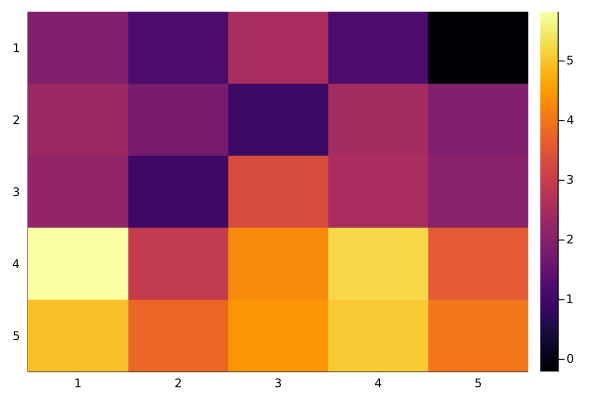

In [48]:
heatmap(data',yflip=true)

In [49]:
mean.(data) #does nothing useful

5×5 Matrix{Float64}:
  1.94297   2.31182   2.18757   5.82432  4.97489
  1.13392   1.76536   0.938966  2.9417   3.78895
  2.52507   0.912648  3.31306   4.29216  4.42154
  1.1239    2.46231   2.52057   5.24691  5.07686
 -0.205772  1.91941   2.05561   3.57072  4.00424

In [50]:
mean(data,dims=1) #better!

1×5 Matrix{Float64}:
 1.30402  1.87431  2.20315  4.37517  4.45329

#### Dictionaries

In [51]:
data = Dict()
data[:cats] = rand(Normal(2.3,1),5)
data["dogs"] = rand(Normal(5.2,1),5)
data[25] = rand(Normal(7.8,1),5)
data

Dict{Any, Any} with 3 entries:
  "dogs" => [6.15007, 4.99768, 5.4376, 5.30059, 4.90585]
  25     => [8.00089, 8.56857, 6.89281, 8.42449, 7.23008]
  :cats  => [1.27666, 2.1732, 0.803409, 2.8579, 1.94351]

In [52]:
keys(data)

KeySet for a Dict{Any, Any} with 3 entries. Keys:
  "dogs"
  25
  :cats

In [53]:
mean(data[:cats])

1.8109362322628335

In [54]:
mean(data["dogs"])

5.358357602085502

In [55]:
mean(data["cats"])

LoadError: KeyError: key "cats" not found

In [56]:
mean(data[Symbol("cats")])

1.8109362322628335

In [57]:
data[Symbol("cats")] |> mean

1.8109362322628335

#### Tuples

In [58]:
fix_seed!()
rn() = rand(Normal())
data = (rn(), rn(),rn())

(0.942970533446119, 0.13392275765318448, 1.5250689085124804)

In [59]:
typeof(data)

Tuple{Float64, Float64, Float64}

In [60]:
mean(data)

0.867320733203928

In [61]:
data[2]

0.13392275765318448

In [62]:
data[2] = 7.8 #Tuples are immutable! 

LoadError: MethodError: no method matching setindex!(::Tuple{Float64, Float64, Float64}, ::Float64, ::Int64)

#### Structs

In [63]:
struct Person
    weight::Float64
    height::Float64
end

In [64]:
someone = Person(102, 180)

Person(102.0, 180.0)

In [65]:
someone.weight = 103 #Structs are immutable unless you state immutable

LoadError: setfield!: immutable struct of type Person cannot be changed

In [66]:
me = Person(102, 180)
you = Person(83, 170)
me + you #can't add persons just like that

LoadError: MethodError: no method matching +(::Person, ::Person)
[0mClosest candidates are:
[0m  +(::Any, ::Any, [91m::Any[39m, [91m::Any...[39m) at /Applications/Julia-1.7.app/Contents/Resources/julia/share/julia/base/operators.jl:655
[0m  +([91m::ChainRulesCore.Tangent{P}[39m, ::P) where P at ~/.julia/packages/ChainRulesCore/ctmSK/src/tangent_arithmetic.jl:146
[0m  +([91m::P[39m, ::T) where {T, X, P<:Polynomials.ChebyshevT{T, X}} at ~/.julia/packages/Polynomials/3kKqS/src/polynomials/ChebyshevT.jl:225
[0m  ...

In [67]:
import Base: + 

function +(x::Person, y::Person)
    Person(x.weight + y.weight, x.height + y.height)
end

+ (generic function with 388 methods)

In [68]:
me + you #Now you can

Person(185.0, 350.0)

In [69]:
import Base: /
function /(x::Person, n::Number)
    Person(x.weight/n, x.height/n)
end

/ (generic function with 175 methods)

In [70]:
mean([me,you]) #With + and / (by number) we can compute the mean of persons

Person(92.5, 175.0)

#### Dataframes 

In [71]:
df = CSV.File("./data/temperatures.csv") |> DataFrame

,Year,Month,Day,Brisbane,GoldCoast
,Int64,Int64,Int64,Float64,Float64
1,2015,1,1,31.3,30.9
2,2015,1,2,30.5,30.1
3,2015,1,3,28.9,30.1
4,2015,1,4,30.2,30.1
5,2015,1,5,28.1,28.0
6,2015,1,6,29.5,29.3
7,2015,1,7,27.1,26.4
8,2015,1,8,28.4,27.7
9,2015,1,9,29.5,29.6


In [72]:
data = df.GoldCoast
mean(data)

26.163835263835264

#### All kind of other descriptive statistics

In [73]:
println("Sample Mean: ", mean(data))
println("Harmonic ≤ Geometric ≤ Arithmetic ",      #\le + [TAB]
            (harmmean(data), geomean(data), mean(data)))

println("Sample Variance: ",var(data))
println("Sample Standard Deviation: ",std(data))
println("Minimum: ", minimum(data))
println("Maximum: ", maximum(data))
println("Median: ", median(data))
println("95th percentile: ", percentile(data, 95))
println("0.95 quantile: ", quantile(data, 0.95))
println("Interquartile range: ", iqr(data),"\n")

summarystats(data)

Sample Mean: 26.163835263835264
Harmonic ≤ Geometric ≤ Arithmetic (25.65423319190783, 25.915563409789065, 26.163835263835264)
Sample Variance: 12.367253570765161
Sample Standard Deviation: 3.516710618001595
Minimum: 15.4
Maximum: 36.5
Median: 26.8
95th percentile: 30.9
0.95 quantile: 30.9
Interquartile range: 5.5



Summary Stats:
Length:         777
Missing Count:  0
Mean:           26.163835
Minimum:        15.400000
1st Quartile:   23.400000
Median:         26.800000
3rd Quartile:   28.900000
Maximum:        36.500000


In [74]:
min(5,2,-3) #Minimum of individual function arguments

-3

In [75]:
minimum([5,2,-3]) #Minimum of an array (AbstractArray)

-3

In [76]:
min([5,2,-3]) #doesn't work

LoadError: MethodError: no method matching min(::Vector{Int64})
[0mClosest candidates are:
[0m  min(::T1, [91m::DataValues.DataValue{T2}[39m) where {T1, T2} at ~/.julia/packages/DataValues/N7oeL/src/scalar/operations.jl:75
[0m  min(::Any, [91m::Missing[39m) at /Applications/Julia-1.7.app/Contents/Resources/julia/share/julia/base/missing.jl:134
[0m  min(::Any, [91m::Any[39m) at /Applications/Julia-1.7.app/Contents/Resources/julia/share/julia/base/operators.jl:506
[0m  ...

In [77]:
min([5,2,-3]...) #The splat operator passes the arguments 

-3

In [78]:
fix_seed!()
data = rand(Normal(),10^6);

In [79]:
@time begin
    minimum(data)
end

  0.000986 seconds (1 allocation: 16 bytes)


-4.872012658441067

In [80]:
@time begin
    min(data...)
end

  0.513146 seconds (2.17 M allocations: 84.859 MiB, 7.32% gc time, 13.12% compilation time)


-4.872012658441067

<a id='something-rand'></a>
# Something `rand`.
[home](#home)

#### The Monty Hall Problem 

In [81]:
fix_seed!()

function montyHall(switch_policy)
    prize, choice = rand(1:3), rand(1:3)
    if prize == choice
        revealed = rand(setdiff(1:3,choice))
    else
        revealed = rand(setdiff(1:3,[prize,choice]))
    end

    if switch_policy
        choice = setdiff(1:3,[revealed,choice])[1]
    end
    return choice == prize
end

N = 10^6
println("Success probability with policy I (stay): ",  sum([montyHall(false) for _ in 1:N])/N)
println("Success probability with policy II (switch): ", sum([montyHall(true) for _ in 1:N])/N)

Success probability with policy I (stay): 0.333997
Success probability with policy II (switch): 0.666754


#### Common random numbers

$$
X \sim \text { Uniform }(0,2 \lambda(1-\lambda))
$$

$$
\mathbb{E}_{\lambda}[X]=\lambda(1-\lambda)
$$

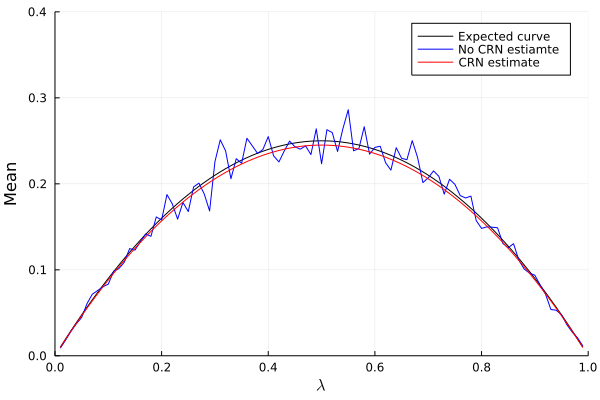

In [82]:
seed = 1
N = 100
λ_grid = 0.01:0.01:0.99

theorM(λ) = mean(Uniform(0,2λ*(1-λ)))
estM(λ) = mean(rand(Uniform(0,2λ*(1-λ)),N))

function estM(λ, seed)
    Random.seed!(seed)
    estM(λ)
end

trueM = theorM.(λ_grid)
estM0 = estM.(λ_grid)
estMCRN = estM.(λ_grid,seed)

plot(λ_grid, trueM, c=:black, label="Expected curve")
plot!(λ_grid, estM0, c=:blue, label="No CRN estiamte")
plot!(λ_grid, estMCRN, c=:red, label="CRN estimate", 
    xlims=(0,1), ylims=(0,0.4), xlabel=L"\lambda", ylabel = "Mean")

#### Multiple RNGs

Say we want to estimate the mean of 
$$
X=\sum_{i=1}^{N} Z_{i}
$$
with $N \sim \operatorname{Poisson}(K \lambda)$ and $Z_{i} \sim \text { Uniform }(0,2(1-\lambda))$  with  $\lambda \in(0,1)$  and $K>0$.

$$
\mathbb{E}_{\lambda}[X]=K \lambda(1-\lambda)
$$

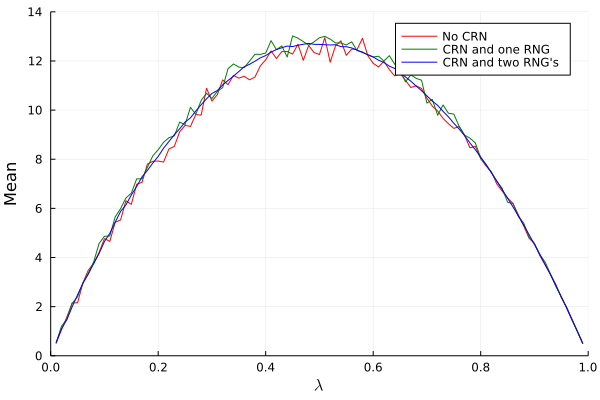

In [83]:
K = 50

prn(λ,rng) = quantile(Poisson(λ),rand(rng))
zDist(λ) = Uniform(0,2*(1-λ))

rv(λ,rng) = sum([rand(rng,zDist(λ)) for _ in 1:prn(K*λ, rng)])
rv2(λ,rng1,rng2) = sum([rand(rng1,zDist(λ)) for _ in 1:prn(K*λ,rng2)])

mEst(λ,rng) = mean([rv(λ,rng) for _ in 1:N])
mEst2(λ,rng1,rng2) = mean([rv2(λ,rng1,rng2) for _ in 1:N])

#No Common Random Numbers (CRN)
function mGraph0(seed)
    singleRng = MersenneTwister(seed)
    [mEst(λ,singleRng) for λ in λ_grid]
end

#CRN but single random number generator (RNG)
mGraph1(seed) = [mEst(λ,MersenneTwister(seed)) for λ in λ_grid]

#CRN with two random number generators
mGraph2(seed1,seed2) = [mEst2(λ,MersenneTwister(seed1), MersenneTwister(seed2)) for λ in λ_grid]

plot(λ_grid,mGraph0(1987), c=:red, label="No CRN")
plot!(λ_grid,mGraph1(1987), c=:green, label="CRN and one RNG")
plot!(λ_grid,mGraph2(1987,1988), c=:blue, label="CRN and two RNG's", xlims=(0,1),ylims=(0,14),
    xlabel=L"\lambda", ylabel = "Mean")

In [84]:
argMaxλ(graph) = λ_grid[findmax(graph)[2]]

M = 10^3
std0 = std([argMaxλ(mGraph0(seed)) for seed in 1:M])
std1 = std([argMaxλ(mGraph1(seed)) for seed in 1:M])
std2 = std([argMaxλ(mGraph2(seed,seed+M)) for seed in 1:M])

println("Standard deviation with no CRN: ", std0)
println("Standard deviation with CRN and single RNG: ", std1)
println("Standard deviation with CRN and two RNGs: ", std2)

Standard deviation with no CRN: 0.03708052002015299
Standard deviation with CRN and single RNG: 0.03411444555309959
Standard deviation with CRN and two RNGs: 0.014645353747396703


<a id='just-rcall'></a>
# Do you still miss R? So Just `RCall`.
[home](#home)

See the docs for [RCall.jl](https://juliainterop.github.io/RCall.jl/stable/)

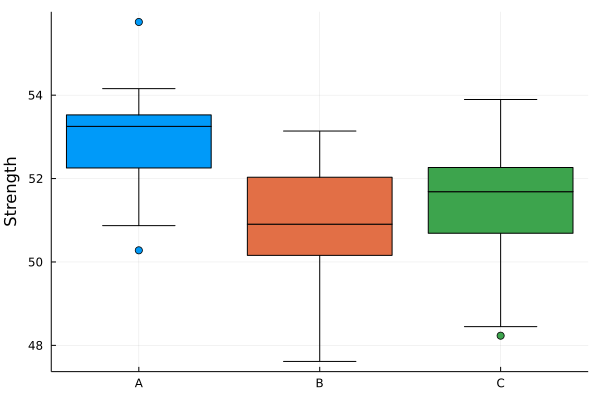

In [85]:
data1 = DataFrame(CSV.File("./data/machine1.csv", header=false))[:,1]
data2 = DataFrame(CSV.File("./data/machine2.csv", header=false))[:,1]
data3 = DataFrame(CSV.File("./data/machine3.csv", header=false))[:,1]

boxplot([data1, data2, data3],xticks=([1,2,3],["A","B","C"]),ylabel="Strength",legend=false)

In [86]:
using RCall

function R_ANOVA(allData)
    data = vcat([ [x fill(i, length(x))] for (i, x) in enumerate(allData) ]...)
    df = DataFrame(data, [:Diameter, :MachNo])
    @rput df

    R"""
    df$MachNo <- as.factor(df$MachNo)
    anova <- summary(aov( Diameter ~ MachNo, data=df))
    fVal <- anova[[1]]["F value"][[1]][1]
    pVal <- anova[[1]]["Pr(>F)"][[1]][1]
    """
    println("R ANOVA f-value: ", @rget fVal)
    println("R ANOVA p-value: ", @rget pVal)
end

R_ANOVA([data1, data2, data3])

R ANOVA f-value: 10.516968568709089
R ANOVA p-value: 0.00014236168817139574


To use Julia from R, use [JuliaCall](https://cran.r-project.org/web/packages/JuliaCall/index.html)

<a id='some-plots'></a>
# Some `Plots`.
[home](#home)

See example [image gallery](https://statisticswithjulia.org/gallery.html) with code - part of "Statistics with Julia" book.

See docs for [Plots.jl](http://docs.juliaplots.org/latest//) and [StatsPlots.jl](https://github.com/JuliaPlots/StatsPlots.jl)

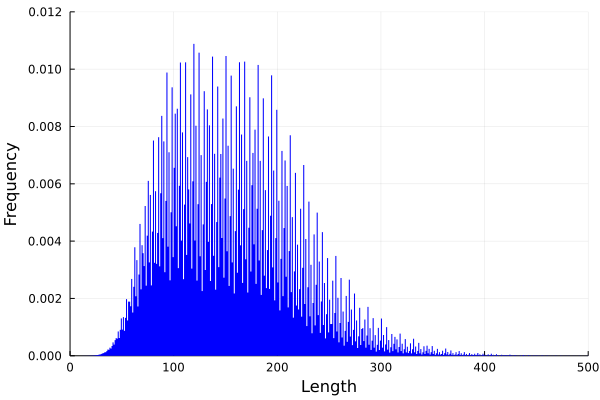

In [87]:
function hailLength(x::Int)
    n = 0
    while x != 1
        if x % 2 == 0
            x = x ÷ 2 #\div + [TAB]
        else
            x = 3x +1
        end
        n += 1
    end
    return n
end

lengths = [hailLength(x₀) for x₀ in 2:10^7] #\_0 + [TAB]

histogram(lengths, bins=1000, normed=:true, 
    fill=(:blue, true), la=0, legend=:none,
    xlims=(0, 500), ylims=(0, 0.012),
    xlabel="Length", ylabel="Frequency")

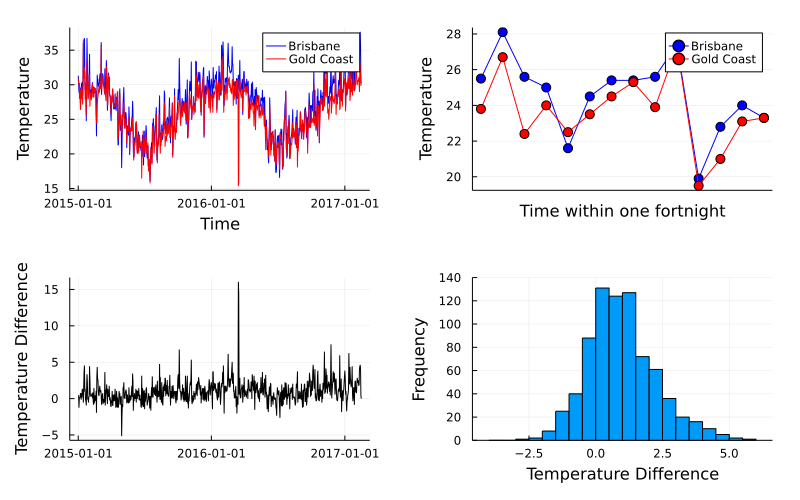

In [88]:
data = CSV.File("./data/temperatures.csv") |> DataFrame
brisbane = data.Brisbane
goldcoast = data.GoldCoast

diff = brisbane - goldcoast
dates = [Date(
            Year(data.Year[i]), 
            Month(data.Month[i]), 
            Day(data.Day[i])
        ) for i in 1:nrow(data)]

fortnightRange = 250:263
brisFortnight = brisbane[fortnightRange]
goldFortnight = goldcoast[fortnightRange]

p1 = plot(dates, [brisbane goldcoast], 
        c=[:blue :red], xlabel="Time", ylabel="Temperature", label=["Brisbane" "Gold Coast"])
p2 = plot(dates[fortnightRange], [brisFortnight goldFortnight], xticks=:none,
        c=[:blue :red], m=(:dot, 5, Plots.stroke(1)), ylabel="Temperature",
        label=["Brisbane" "Gold Coast"], xlabel="Time within one fortnight")
p3 = plot(dates, diff, 
        c=:black, ylabel="Temperature Difference",legend=false)
p4 = histogram(diff, bins=-4:0.5:6, 
        ylims=(0,140), legend = false,
        xlabel="Temperature Difference", ylabel="Frequency")
plot(p1,p2,p3,p4, size = (800,500), margin = 5mm)

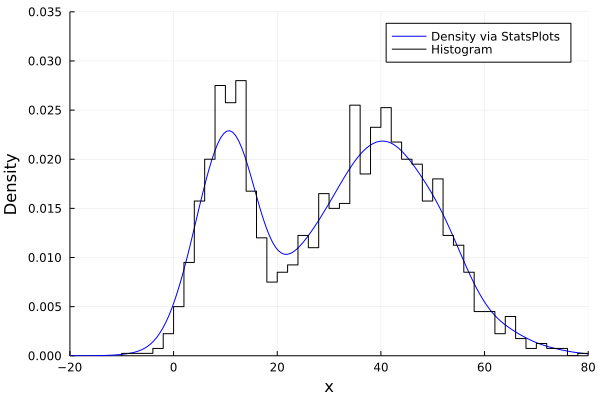

In [89]:
fix_seed!()

μ₁, σ₁ = 10, 5 #\mu + [TAB] \_1 + [TAB] etc...
μ₂, σ₂ = 40, 12
dist1, dist2 = Normal(μ₁,σ₁), Normal(μ₂,σ₂)
p = 0.3
mixRv() = (rand() <= p) ? rand(dist1) : rand(dist2)

n = 2000
data = [mixRv() for _ in 1:n]

density(data, c=:blue, label="Density via StatsPlots", xlims=(-20,80), ylims=(0,0.035))
stephist!(data, bins=50, c=:black, norm=true, label="Histogram", xlabel="x", ylabel = "Density")

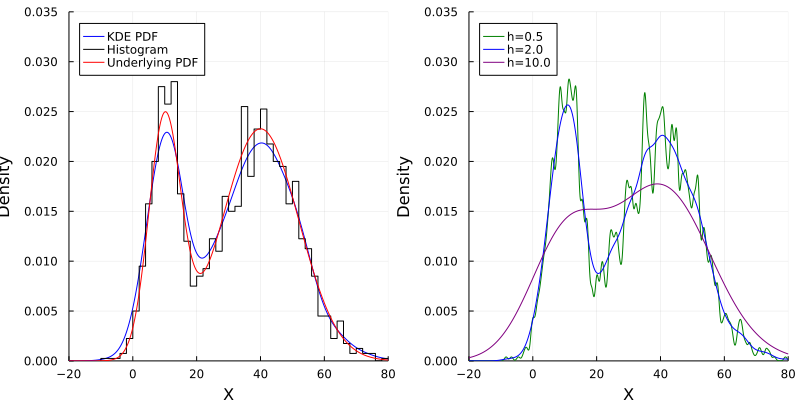

In [90]:
mixPDF(x) = p*pdf(dist1,x) + (1-p)*pdf(dist2,x)

kdeDist = kde(data)

xGrid = -20:0.1:80
pdfKDE = pdf(kdeDist,xGrid)

p1 = plot(xGrid, pdfKDE, c=:blue, label="KDE PDF")
stephist!(data, bins=50, c=:black, normed=:true, label="Histogram")
plot!(xGrid, mixPDF.(xGrid), c=:red, label="Underlying PDF",
    xlims=(-20,80), ylims=(0,0.035), legend=:topleft,
    xlabel="X", ylabel = "Density")

hVals = [0.5,2,10]
kdeS = [kde(data,bandwidth=h) for h in hVals]

p2 = plot(xGrid, pdf(kdeS[1],xGrid), c = :green, label= "h=$(hVals[1])")
plot!(xGrid, pdf(kdeS[2],xGrid), c = :blue, label= "h=$(hVals[2])")
plot!(xGrid, pdf(kdeS[3],xGrid), c = :purple, label= "h=$(hVals[3])",
    xlims=(-20,80), ylims=(0,0.035), legend=:topleft, 
    xlabel="X", ylabel = "Density")

plot(p1,p2,size = (800,400))

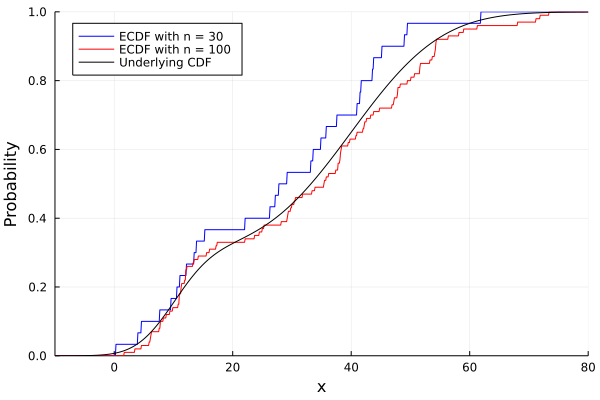

In [91]:
fix_seed!()

mixCDF(x) = p*cdf(dist1,x) + (1-p)*cdf(dist2,x)

n = [30, 100]
data1 = [mixRv() for _ in 1:n[1]]
data2 = [mixRv() for _ in 1:n[2]]

empiricalCDF1 = ecdf(data1)
empiricalCDF2 = ecdf(data2)

xGrid = -10:0.1:80
plot(xGrid,empiricalCDF1.(xGrid), c=:blue, label="ECDF with n = $(n[1])")
plot!(xGrid,empiricalCDF2.(xGrid), c=:red, label="ECDF with n = $(n[2])")
plot!(xGrid, mixCDF.(xGrid), c=:black, label="Underlying CDF",
    xlims=(-10,80), ylims=(0,1), 
    xlabel="x", ylabel="Probability", legend=:topleft)

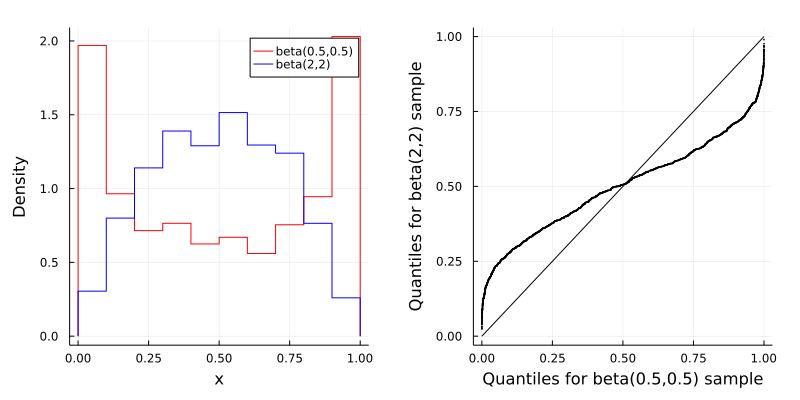

In [92]:
fix_seed!()

b1, b2 = 0.5 , 2
dist1, dist2, = Beta(b1,b1), Beta(b2,b2)
 
n = 2000
data1 = rand(dist1,n)
data2 = rand(dist2,n)

stephist(data1, bins=15, label = "beta($b1,$b1)", c = :red, normed = true)
p1 = stephist!(data2, bins=15, label = "beta($b2,$b2)",
        c = :blue, xlabel="x", ylabel="Density",normed = true)

p2 = qqplot(data1, data2, c=:black, ms=1, msw =0,
        xlabel="Quantiles for beta($b1,$b1) sample",
        ylabel="Quantiles for beta($b2,$b2) sample",
        legend=false)

plot(p1, p2, size=(800,400), margin = 5mm)

<a id='favorite-distribution'></a>
# Your favorite `Distribution`.
[home](#home)

See [Docs for `Distributions.jl`](https://juliastats.org/Distributions.jl/latest/)

In [93]:
dist = Normal(2.5,1.2)

Normal{Float64}(μ=2.5, σ=1.2)

In [94]:
mean(dist), var(dist)

(2.5, 1.44)

In [95]:
fix_seed!()
rand(dist,3,2,5) #a 3-tensor

3×2×5 Array{Float64, 3}:
[:, :, 1] =
 3.63156  2.64868
 2.66071  1.05307
 4.33008  2.87418

[:, :, 2] =
 2.21843  2.40329
 1.19518  1.52508
 3.05477  0.0267587

[:, :, 3] =
 2.87567  4.68919
 1.92468  1.23004
 1.36673  2.8506

[:, :, 4] =
 3.99629  1.04674
 1.98487  1.80585
 2.46986  2.59223

[:, :, 5] =
 1.30508  0.70409
 1.27199  3.16948
 2.34784  2.07221

In [96]:
? NegativeBinomial

search: NegativeBinomial NegativeBinomialLink



```
NegativeBinomial(r,p)
```

A *Negative binomial distribution* describes the number of failures before the `r`th success in a sequence of independent Bernoulli trials. It is parameterized by `r`, the number of successes, and `p`, the probability of success in an individual trial.

$$
P(X = k) = {k + r - 1 \choose k} p^r (1 - p)^k, \quad \text{for } k = 0,1,2,\ldots.
$$

The distribution remains well-defined for any positive `r`, in which case

$$
P(X = k) = \frac{\Gamma(k+r)}{k! \Gamma(r)} p^r (1 - p)^k, \quad \text{for } k = 0,1,2,\ldots.
$$

```julia
NegativeBinomial()        # Negative binomial distribution with r = 1 and p = 0.5
NegativeBinomial(r, p)    # Negative binomial distribution with r successes and success rate p

params(d)       # Get the parameters, i.e. (r, p)
succprob(d)     # Get the success rate, i.e. p
failprob(d)     # Get the failure rate, i.e. 1 - p
```

External links:

  * [Negative binomial distribution on Wolfram](https://reference.wolfram.com/language/ref/NegativeBinomialDistribution.html)

Note: The definition of the negative binomial distribution in Wolfram is different from the [Wikipedia definition](http://en.wikipedia.org/wiki/Negative_binomial_distribution). In Wikipedia, `r` is the number of failures and `k` is the number of successes.


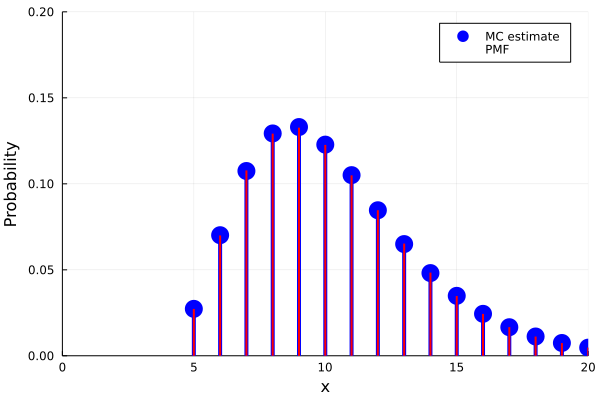

In [97]:
fix_seed!()

function rouletteSpins(r,p)
    x = 0
    wins = 0
    while true
        x += 1
        if rand() < p
            wins += 1
            if wins == r
                return x
            end
        end
    end
end

r, p, N = 5, 18/37,10^6
xGrid = r:r+15

mcEstimate = counts([rouletteSpins(r,p) for _ in 1:N],xGrid)/N

nbDist = NegativeBinomial(r,p)
nbPmf = [pdf(nbDist,x-r) for x in xGrid]

plot( xGrid, mcEstimate, 
    line=:stem, marker=:circle, c=:blue, 
    ms=10, msw=0, lw=4, label="MC estimate")
plot!( xGrid, nbPmf, line=:stem, 
    marker=:xcross, c=:red, ms=6, msw=0, lw=2, label="PMF", 
    xlims=(0,maximum(xGrid)), ylims=(0,0.2), 
    xlabel="x", ylabel="Probability")

┌ Info: Saved animation to 
│   fn = /Users/uqjnazar/git/mine/StatisticsWithJuliaFromTheGroundUp-2022/sample_animation.gif
└ @ Plots /Users/uqjnazar/.julia/packages/Plots/GGa6i/src/animation.jl:126


Plots.AnimatedGif("/Users/uqjnazar/git/mine/StatisticsWithJuliaFromTheGroundUp-2022/sample_animation.gif")
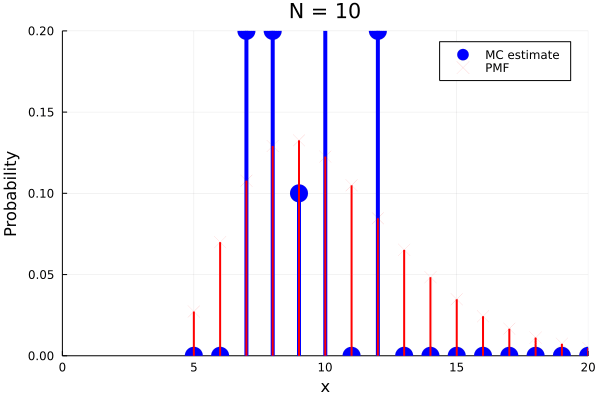

In [98]:
function plot_it(N)
    fix_seed!()
    mcEstimate = counts([rouletteSpins(r,p) for _ in 1:N],xGrid)/N

    nbDist = NegativeBinomial(r,p)
    nbPmf = [pdf(nbDist,x-r) for x in xGrid]

    plot( xGrid, mcEstimate, 
        line=:stem, marker=:circle, c=:blue, 
        ms=10, msw=0, lw=4, label="MC estimate")
    plot!( xGrid, nbPmf, line=:stem, 
        marker=:xcross, c=:red, ms=6, msw=0, lw=2, label="PMF", 
        xlims=(0,maximum(xGrid)), ylims=(0,0.2), 
        xlabel="x", ylabel="Probability",
        title="N = $N")
end

anim = Animation()

for N in union(10:10:100,200:100,1000,2000:1000:10^4)
    plot_it(N)
    frame(anim)
end

gif(anim,"sample_animation.gif",fps = 3)

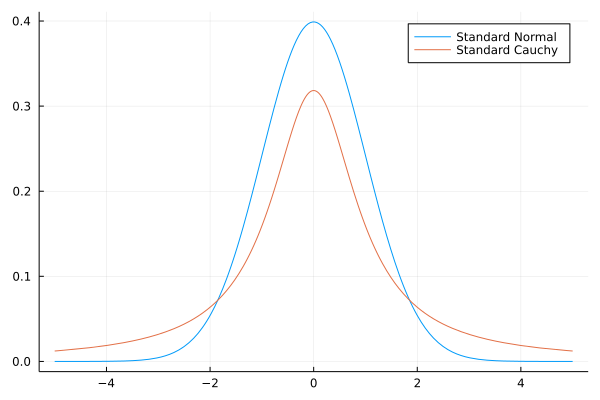

In [99]:
plot((x)->pdf(Normal(),x),label = "Standard Normal")
plot!((x)->pdf(Cauchy(),x),label = "Standard Cauchy")

In [100]:
fix_seed!()

n = 10^6
data = rand(Normal(), n)
# data = rand(Cauchy(),n) #Try this instead
averages = accumulate(+,data) ./ (1:n)

plot( 1:n, averages, 
    c=:blue, legend=:none, xscale=:log10, xlims=(1,n), xlabel="n", ylabel="Running average")

In [101]:
fix_seed!()

N = 10^4

Σ = [ 6 4 ;
         4 9]
μ = [15 ; 
       20]
A = cholesky(Σ).L

rngGens = [()->rand(Normal()), 
           ()->rand(Uniform(-sqrt(3),sqrt(3))),
           ()->rand(Exponential())-1]

rv(rg) = A*[rg(),rg()] + μ
    
data = [[rv(r) for _ in 1:N] for r in rngGens]

stats(data) = begin
    data1, data2 = first.(data),last.(data)
    println(round(mean(data1),digits=2), "\t",round(mean(data2),digits=2),"\t",
            round(var(data1),digits=2), "\t", round(var(data2),digits=2), "\t",
            round(cov(data1,data2),digits=2))
end

println("Mean1\tMean2\tVar1\tVar2\tCov")
for d in data
    stats(d)
end

scatter(first.(data[1]), last.(data[1]), c=:blue, ms=1, msw=0, label="Normal")
scatter!(first.(data[2]), last.(data[2]), c=:red, ms=1, msw=0, label="Uniform")
scatter!(first.(data[3]), last.(data[3]), c=:green, ms=1, msw=0,label="Exponential",
    xlims=(0,40), ylims=(0,40), legend=:bottomright, ratio=:equal,
    xlabel=L"X_1", ylabel=L"X_2")

Mean1	Mean2	Var1	Var2	Cov
15.0	20.03	6.04	8.92	4.02
15.0	19.97	6.07	8.95	3.97
14.96	19.93	5.84	8.55	3.85


In [102]:
dist = MvNormal([1,1],[2 2.3; 2.3 4])

FullNormal(
dim: 2
μ: [1.0, 1.0]
Σ: [2.0 2.3; 2.3 4.0]
)


In [103]:
cor(dist)

2×2 Matrix{Float64}:
 1.0       0.813173
 0.813173  1.0

In [104]:
rand(dist,20)

2×20 Matrix{Float64}:
 -0.274472  4.27656  1.16665  2.17362  …  -0.600927  2.13761  -0.407002
  0.519552  5.06635  1.35249  2.68086      0.332945  3.60326  -0.744012

<a id='love-dataframes'></a>
# We love `DataFrames`.
[home](#home)

See also:

* See [Dataframes tutorial](https://github.com/bkamins/JuliaCon2021-DataFrames-Tutorial) or [here](https://pretalx.com/juliacon2021/talk/FXZXMB/) by Bogumił Kamiński.
* Docs for [DataFrames.jl](https://dataframes.juliadata.org/stable/).

In [105]:
ENV["LINES"] = 10
data = CSV.File("./data/purchaseData.csv") |> DataFrame

,Name,Date,Grade,Price
,String15?,String15?,String1?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,ASHELY,5/08/2008,E,24311
4,KHADIJAH,2/09/2008,missing,38904
5,TANJA,1/12/2008,C,47052
6,JUDIE,17/05/2008,D,34365
7,NOE,15/08/2008,A,79344
8,JACALYN,7/10/2008,E,21474
9,SANDY,5/04/2008,D,missing


In [106]:
size(data)

(200, 4)

In [107]:
names(data)

4-element Vector{String}:
 "Name"
 "Date"
 "Grade"
 "Price"

In [108]:
first(data, 6)

,Name,Date,Grade,Price
,String15?,String15?,String1?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,ASHELY,5/08/2008,E,24311
4,KHADIJAH,2/09/2008,missing,38904
5,TANJA,1/12/2008,C,47052
6,JUDIE,17/05/2008,D,34365


In [109]:
describe(data)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Union
1,Name,,ABBEY,,ZACHARY,17,"Union{Missing, String15}"
2,Date,,1/07/2008,,9/10/2008,4,"Union{Missing, String15}"
3,Grade,,A,,E,13,"Union{Missing, String1}"
4,Price,39702.0,8257,38045.5,79893,14,"Union{Missing, Int64}"


In [110]:
println("Grade of person 1: ", data[1, 3], 
        ", ", data[1,:Grade], 
        ", ", data.Grade[1])

Grade of person 1: A, A, A


In [111]:
data[[1,2,4], :]

,Name,Date,Grade,Price
,String15?,String15?,String1?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,KHADIJAH,2/09/2008,missing,38904


In [112]:
data[13:15, :Name]

3-element Vector{Union{Missing, String15}}:
 "SAMMIE"
 missing
 "STACEY"

In [113]:
data.Name[13:15]

3-element Vector{Union{Missing, String15}}:
 "SAMMIE"
 missing
 "STACEY"

In [114]:
data[13:15, [:Name]]

,Name
,String15?
1,SAMMIE
2,missing
3,STACEY


#### Mising values

In [115]:
mean(data.Price)

missing

In [116]:
ismissing.(data.Price) |> sum

14

In [117]:
mean(skipmissing(data.Price))

39702.01075268817

In [118]:
data.Grade[1:4]

4-element PooledArrays.PooledVector{Union{Missing, String1}, UInt32, Vector{UInt32}}:
 "A"
 "B"
 "E"
 missing

In [119]:
coalesce.(data.Grade, "QQ")[1:4]

4-element Vector{AbstractString}:
 "A"
 "B"
 "E"
 "QQ"

In [120]:
dropmissing(data,:Price)

,Name,Date,Grade,Price
,String15?,String15?,String1?,Int64
1,MARYANNA,14/09/2008,A,79700
2,ASHELY,5/08/2008,E,24311
3,KHADIJAH,2/09/2008,missing,38904
4,TANJA,1/12/2008,C,47052
5,JUDIE,17/05/2008,D,34365
6,NOE,15/08/2008,A,79344
7,JACALYN,7/10/2008,E,21474
8,ALEJANDRA,16/12/2008,E,20916
9,GARY,8/05/2008,C,40081


In [121]:
completecases(data) |> sum

153

In [122]:
full_obs = completecases(data) |> findall

153-element Vector{Int64}:
   1
   3
   5
   ⋮
 199
 200

In [123]:
data[setdiff(1:size(data,1), full_obs),:]

,Name,Date,Grade,Price
,String15?,String15?,String1?,Int64?
1,REBECCA,11/03/2008,B,missing
2,KHADIJAH,2/09/2008,missing,38904
3,SANDY,5/04/2008,D,missing
4,ROSELEE,29/06/2008,missing,37661
5,missing,12/12/2008,E,17328
6,RASHIDA,missing,C,44597
7,MINERVA,31/07/2008,missing,45751
8,JARRETT,30/11/2008,missing,41182
9,missing,1/10/2008,E,20229


<a id='inference'></a>
# Gotta have some basic inference.
[home](#home)

#### Point estimation

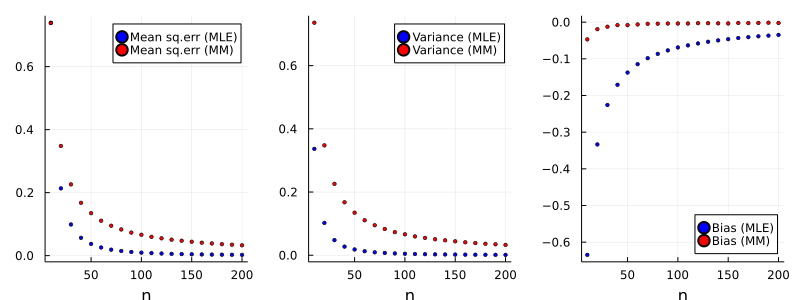

In [124]:
fix_seed!()

N = 10^5
nMin, nStep, nMax = 10, 10, 200
nn = Int(nMax/nStep)
sampleSizes = nMin:nStep:nMax
trueB = 5
trueDist = Uniform(-2, trueB)

#MLE for the upper bound
MLEest(data) = maximum(data)

#Method of moments estimator for the upper bound
MMest(data)  = mean(data) + sqrt(3)*std(data)

res = Dict{Symbol,Array{Float64}}( ((sym) -> sym => Array{Float64}(undef,nn)).(
                                [:MSeMLE,:MSeMM, :VarMLE,:VarMM,:BiasMLE,:BiasMM]))

for (i, n) in enumerate(sampleSizes)
    mleEst, mmEst = Array{Float64}(undef, N), Array{Float64}(undef, N) 
    for j in 1:N
        sample    = rand(trueDist,n)
        mleEst[j] = MLEest(sample)
        mmEst[j]  = MMest(sample)
    end
    meanMLE, meanMM = mean(mleEst), mean(mmEst)
    varMLE, varMM = var(mleEst), var(mmEst)

    res[:MSeMLE][i] = varMLE + (meanMLE - trueB)^2
    res[:MSeMM][i] = varMM + (meanMM - trueB)^2
    res[:VarMLE][i] = varMLE
    res[:VarMM][i] = varMM
    res[:BiasMLE][i] = meanMLE - trueB
    res[:BiasMM][i] = meanMM - trueB
end

p1 = scatter(sampleSizes, [res[:MSeMLE] res[:MSeMM]], c=[:blue :red],
    label=["Mean sq.err (MLE)" "Mean sq.err (MM)"])
p2 = scatter(sampleSizes, [res[:VarMLE] res[:VarMM]], c=[:blue :red],
    label=["Variance (MLE)" "Variance (MM)"])
p3 = scatter(sampleSizes, [res[:BiasMLE] res[:BiasMM]], c=[:blue :red],
    label=["Bias (MLE)" "Bias (MM)"],legend = :bottomright)

plot(p1, p2, p3, ms=2, shape=:circle, xlabel="n", 
    layout=(1,3), size=(800, 300), margin = 2mm)

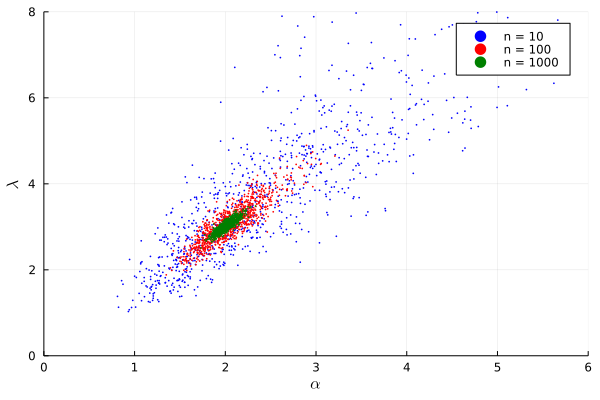

In [125]:
fix_seed!()

eq(alpha, xb, xbl) = log(alpha) - digamma(alpha) - log(xb) + xbl

actualAlpha, actualLambda = 2, 3
gammaDist = Gamma(actualAlpha,1/actualLambda)

function mle(sample)
    alpha  = find_zero( (a)->eq(a,mean(sample),mean(log.(sample))), 1)
    lambda = alpha/mean(sample)
    return [alpha,lambda]
end

N = 10^3

mles10   = [mle(rand(gammaDist,10)) for _ in 1:N]
mles100  = [mle(rand(gammaDist,100)) for _ in 1:N]
mles1000 = [mle(rand(gammaDist,1000)) for _ in 1:N]

scatter(first.(mles10), last.(mles10), 
    c=:blue, ms=1, msw=0, label="n = 10")
scatter!(first.(mles100), last.(mles100), 
    c=:red, ms=1, msw=0, label="n = 100")
scatter!(first.(mles1000), last.(mles1000), 
    c=:green, ms=1, msw=0, label="n = 1000", 
    xlims=(0,6), ylims=(0,8), xlabel=L"\alpha", ylabel=L"\lambda")

#### Confidence Intervals

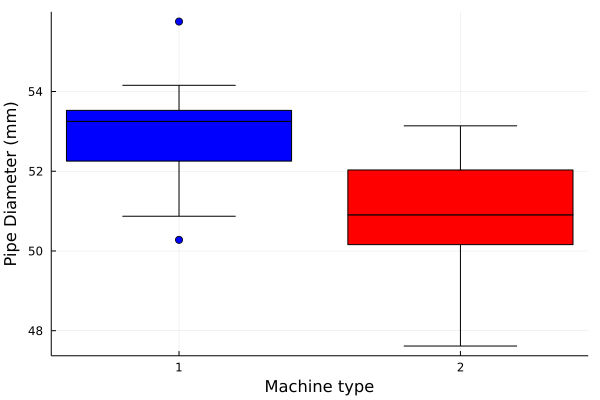

In [126]:
data1 = (CSV.File("./data/machine1.csv", header=false) |> DataFrame)[:,1]
data2 = (CSV.File("./data/machine2.csv", header=false) |> DataFrame)[:,1]
boxplot([data1,data2], c=[:blue :red], label="", 
    xticks=([1:2;], ["1", "2"]), xlabel="Machine type",
    ylabel="Pipe Diameter (mm)")

In [127]:
α = 0.05 #\alpha + [TAB]
confint(EqualVarianceTTest(data1,data2),α)

(1.1127539574575822, 2.90486485574026)

In [128]:
#Doing it manually
xBar1, xBar2 = mean(data1), mean(data2)
n1, n2 = length(data1), length(data2)
t = quantile(TDist(n1+n2-2),1-α/2)

s1, s2 = std(data1), std(data2)
sP = sqrt(((n1-1)*s1^2 + (n2-1)*s2^2) / (n1+n2-2))

(xBar1 - xBar2 - t*sP* sqrt(1/n1 + 1/n2), xBar1 - xBar2 + t*sP* sqrt(1/n1 + 1/n2))

(1.1127539574575822, 2.90486485574026)

#### Hypothesis Tests

In [129]:
δ₀ = 0
test_result =UnequalVarianceTTest(data1, data2, δ₀)

Two sample t-test (unequal variance)
------------------------------------
Population details:
    parameter of interest:   Mean difference
    value under h_0:         0
    point estimate:          2.00881
    95% confidence interval: (1.096, 2.922)

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-04

Details:
    number of observations:   [20,18]
    t-statistic:              4.483705005611673
    degrees of freedom:       31.82453144280282
    empirical standard error: 0.4480244360600785


In [130]:
test_result.df

31.82453144280282

In [131]:
pvalue(test_result)

8.936189820682969e-5

In [132]:
methods(pvalue)

# 35 methods for generic function "pvalue":
[1] pvalue(x::KSampleADTest) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/anderson_darling.jl:241
[2] pvalue(x::FisherTLinearAssociation; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/circular.jl:138
[3] pvalue(x::ExactMannWhitneyUTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/mann_whitney.jl:136
[4] pvalue(t::HypothesisTests.VarianceEqualityTest{TD}; tail) where TD<:(ContinuousDistribution) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/var_equality.jl:30
[5] pvalue(test::CorrelationTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/correlation.jl:84
[6] pvalue(x::HypothesisTests.TTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/t.jl:31
[7] pvalue(x::ApproximateMannWhitneyUTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/mann_whitney.jl:224
[8] pvalue(test::WaldWolfowitzTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/wald_wolfowitz.jl:15
[9] pvalue(dist::Distribution{Univariate, Continuous}, x::Number; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/HypothesisTests.jl:72
[10] pvalue(dist::Distribution{Univariate, Discrete}, x::Number; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/HypothesisTests.jl:85
[11] pvalue(x::ApproximateSignedRankTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/wilcoxon.jl:227
[12] pvalue(T::HypothesisTests.HotellingT2TestTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/hotelling.jl:8
[13] pvalue(x::ExactSignedRankTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/wilcoxon.jl:135
[14] pvalue(x::HypothesisTests.ZTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/z.jl:31
[15] pvalue(x::HypothesisTests.ExactKSTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/kolmogorov_smirnov.jl:80
[16] pvalue(apt::HypothesisTests.PermutationTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/permutation.jl:47
[17] pvalue(t::OneSampleADTest) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/anderson_darling.jl:55
[18] pvalue(x::KruskalWallisTest) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/kruskal_wallis.jl:95
[19] pvalue(x::BreuschGodfreyTest) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/breusch_godfrey.jl:79
[20] pvalue(B::BartlettTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/bartlett.jl:53
[21] pvalue(x::SignTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/binomial.jl:217
[22] pvalue(x::BinomialTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/binomial.jl:69
[23] pvalue(x::VarianceFTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/f.jl:66
[24] pvalue(x::RayleighTest) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/circular.jl:63
[25] pvalue(x::BoxPierceTest) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/box_test.jl:74
[26] pvalue(x::DurbinWatsonTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/durbin_watson.jl:180
[27] pvalue(x::ApproximateOneSampleKSTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/kolmogorov_smirnov.jl:126
[28] pvalue(x::PowerDivergenceTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/

In [133]:
@which pvalue(test_result)

pvalue(x::HypothesisTests.TTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/Dvf6v/src/t.jl:31

In [134]:
xBar1, s1, n1 = mean(data1), std(data1), length(data1)
xBar2, s2, n2 = mean(data2), std(data2), length(data2)

v = ( s1^2/n1 + s2^2/n2 )^2 / ( (s1^2/n1)^2/(n1-1) + (s2^2/n2)^2/(n2-1)  )
testStatistic = ( xBar1-xBar2 - δ₀ )  / sqrt( s1^2/n1 + s2^2/n2 )
pVal = 2*ccdf(TDist(v), abs(testStatistic))

println("Manually calculated degrees of freedom, v: ", v)
println("Manually calculated test statistic: ", testStatistic)
println("Manually calculated p-value: ", pVal, "\n")

Manually calculated degrees of freedom, v: 31.82453144280283
Manually calculated test statistic: 4.483705005611673
Manually calculated p-value: 8.936189820683007e-5



In [135]:
data = CSV.File("./data/fertilizer.csv") |> DataFrame

control = data.Control
fertilizer = data.FertilizerX

subGroups = collect(combinations([control;fertilizer],10))

meanFert = mean(fertilizer)
pVal = sum([mean(i) >= meanFert for i in subGroups])/length(subGroups)
println("p-value = ", pVal)

p-value = 0.023972157873086666


<a id='linear-models'></a>
# Linear models at our core.
[home](#home)

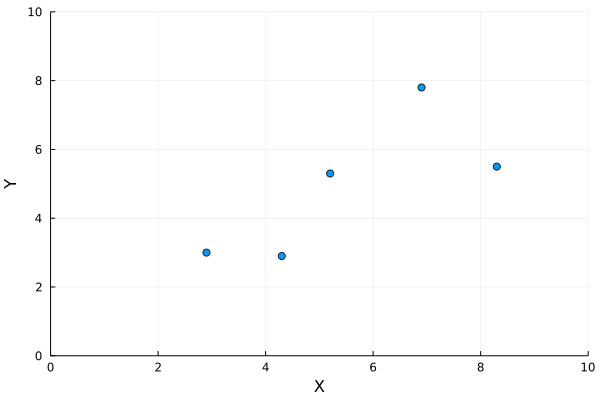

In [136]:
data = CSV.File("./data/L1L2data.csv") |> DataFrame
xVals, yVals = data[:,1], data[:,2]
scatter(xVals,yVals,label=false,xlim=(0,10),ylim=(0,10),xlabel="X", ylabel="Y")

In [137]:
n = length(xVals)
A = [ones(n) xVals] #The "design matrix"

5×2 Matrix{Float64}:
 1.0  2.9
 1.0  4.3
 1.0  5.2
 1.0  6.9
 1.0  8.3

In [138]:
# Approach A
xBar, yBar = mean(xVals),mean(yVals)
sXX, sXY = ones(n)'*(xVals.-xBar).^2 , dot(xVals.-xBar,yVals.-yBar)
b1A = sXY/sXX
b0A = yBar - b1A*xBar

# Approach B
b1B = cor(xVals,yVals)*(std(yVals)/std(xVals))
b0B = yBar - b1B*xBar

# Approach C
b0C, b1C = A'A \ A'yVals

# Approach D
Adag = inv(A'*A)*A'
b0D, b1D = Adag*yVals

# Approach E
b0E, b1E = pinv(A)*yVals

# Approach F
b0F, b1F = A\yVals

# Approach G
F = qr(A)
Q, R = F.Q, F.R
b0G, b1G = (inv(R)*Q')*yVals

# Approach H
F = svd(A)
V, Sp, Us = F.V, Diagonal(1 ./ F.S), F.U'
b0H, b1H = (V*Sp*Us)*yVals

# Approach I
eta, eps = 0.002, 10^-6.
b, bPrev = [0,0], [1,1]
while norm(bPrev-b) >= eps
    bPrev = b
    b = b - eta*2*A'*(A*b - yVals)
end
b0I, b1I = b[1], b[2]

# Approach J
modelJ = lm(@formula(Y ~ X), data)
b0J, b1J = coef(modelJ)

# Approach K
modelK = glm(@formula(Y ~ X), data, Normal())
b0K, b1K = coef(modelK)

println(round.([b0A,b0B,b0C,b0D,b0E,b0F,b0G,b0H,b0I,b0J,b0K],digits=3))
println(round.([b1A,b1B,b1C,b1D,b1E,b1F,b1G,b1H,b1I,b1J,b1K],digits=3))

[0.945, 0.945, 0.945, 0.945, 0.945, 0.945, 0.945, 0.945, 0.944, 0.945, 0.945]
[0.716, 0.716, 0.716, 0.716, 0.716, 0.716, 0.716, 0.716, 0.717, 0.716, 0.716]


***Output of LM Model:
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Height ~ 1 + Weight

Coefficients:
────────────────────────────────────────────────────────────────────────────
                  Coef.  Std. Error      t  Pr(>|t|)   Lower 95%   Upper 95%
────────────────────────────────────────────────────────────────────────────
(Intercept)  135.793      1.95553    69.44    <1e-99  131.937     139.649
Weight         0.532299   0.0293556  18.13    <1e-43    0.474409    0.590188
────────────────────────────────────────────────────────────────────────────

***Output of GLM Model:
StatsModels.TableRegressionModel{GeneralizedLinearModel{GLM.GlmResp{Vector{Float64}, Normal{Float64}, IdentityLink}, GLM.DensePredChol{Float64, Cholesky{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Height ~ 1 + Weight

Coefficients:
───────────────────────────────────────────────────────────

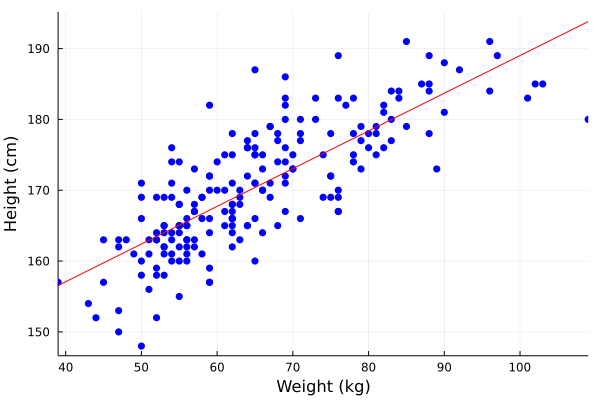

In [139]:
data = CSV.File("./data/weightHeight.csv") |> DataFrame

lm1 = lm(@formula(Height ~ Weight), data)
lm2 = fit(LinearModel,@formula(Height ~ Weight), data)

glm1 = glm(@formula(Height ~ Weight), data, Normal(), IdentityLink())
glm2 = fit(GeneralizedLinearModel,@formula(Height ~ Weight), data, Normal(), IdentityLink())

println("***Output of LM Model:")
println(lm1)
println("\n***Output of GLM Model:")
println(glm1)

pred(x) = coef(lm1)'*[1, x]

println("\n***Individual methods applied to model output:")
println("Deviance: ",deviance(lm1))
println("Standard error: ",stderror(lm1))
println("Degrees of freedom: ",dof_residual(lm1))
println("Covariance matrix: ",vcov(lm1))

yVals = data.Height
SStotal = sum((yVals .- mean(yVals)).^2)

println("R squared (calculated in two ways):",r2(lm1),
        ",\t", 1 - deviance(lm1)/SStotal)

println("MSE (calculated in two ways: ",deviance(lm1)/dof_residual(lm1),
        ",\t",sum((pred.(data.Weight) - data.Height).^2)/(size(data)[1] - 2))

xlims = [minimum(data.Weight), maximum(data.Weight)]
scatter(data.Weight, data.Height, c=:blue, msw=0)
plot!(xlims, pred.(xlims), 
    c=:red, xlims=(xlims), 
    xlabel="Weight (kg)", ylabel="Height (cm)", legend=:none)

#### Multiple variables

In [140]:
df = RDatasets.dataset("MASS", "cpus")
df.Freq = map( x->10^9/x , df.CycT)

model = lm(@formula(Perf ~ MMax + Cach + ChMax + Freq), df)
pred(x) = round(coef(model)'*vcat(1,x),digits = 3)

println("n = ", size(df)[1])
println("(Avg,Std) of observed performance: ", (mean(df.Perf),std(df.Perf)))
println(model)
println("Estimated performance for computer A: ", pred([32000, 32, 32, 4*10^7]))
println("Estimated performance for computer B: ", pred([32000, 16, 32, 6*10^7]))

n = 209
(Avg,Std) of observed performance: (105.61722488038278, 160.83058719907774)
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Perf ~ 1 + MMax + Cach + ChMax + Freq

Coefficients:
───────────────────────────────────────────────────────────────────────────────────
                    Coef.   Std. Error      t  Pr(>|t|)     Lower 95%     Upper 95%
───────────────────────────────────────────────────────────────────────────────────
(Intercept)  -46.5763      7.62382      -6.11    <1e-08  -61.6078      -31.5447
MMax           0.00841457  0.000639214  13.16    <1e-28    0.00715426    0.00967489
Cach           0.872508    0.152825      5.71    <1e-07    0.571189      1.17383
ChMax          0.96736     0.234847      4.12    <1e-04    0.504321      1.4304
Freq           9.74951e-7  5.5502e-7     1.76    0.0805   -1.1936e-7     2.06926e-6
──────────────────────────────────────

#### Variable selection with LASSO

LassoPath (2) solutions for 7 predictors in 84 iterations):
───────────────────────────
        λ   pct_dev  ncoefs
───────────────────────────
[1]  54.0  0.673402       4
[2]  54.2  0.67203        3
───────────────────────────
Coefficients: [0.0, 0.005294014227461394, 0.0056046927214597085, 0.1452042414908439, 0.0, 0.0]


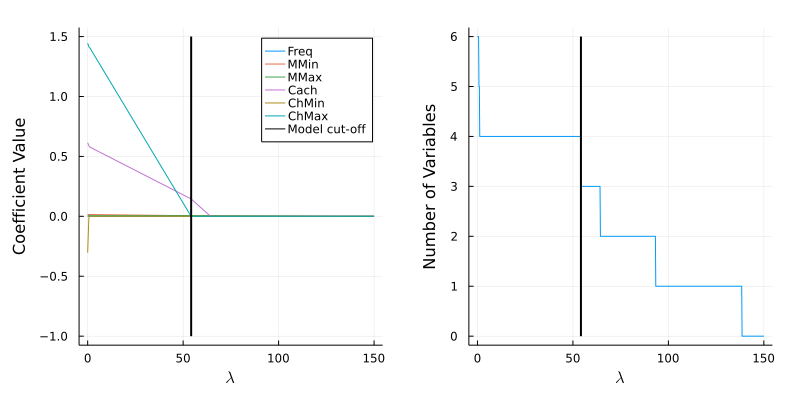

In [141]:
df = RDatasets.dataset("MASS", "cpus")
df.Freq = map( x->10^9/x , df.CycT)
df = df[:, [:Perf, :Freq, :MMin, :MMax, :Cach, :ChMin, :ChMax]]
X = [df.Freq df.MMin df.MMax df.Cach df.ChMin df.ChMax]
Y = df.Perf

targetNumVars = 3

lambdaStep = 0.2
lamGrid = collect(0:lambdaStep:150)
lassoFit = fit(LassoPath,X, Y, λ = lamGrid);
dd = Array(lassoFit.coefs)'
nV = sum(dd .!= 0.0 ,dims=2)

goodLambda = lamGrid[findfirst((n)->n==targetNumVars,nV)]
newFit = fit(LassoPath,X, Y, λ = [goodLambda - lambdaStep, goodLambda])
println(newFit)
println("Coefficients: ", Array(newFit.coefs)'[2,:])

p1 = plot(lassoFit.λ, dd, label = ["Freq" "MMin" "MMax" "Cach" "ChMin" "ChMax"],
    ylabel = "Coefficient Value")
plot!([goodLambda,goodLambda],[-1,1.5],c=:black, lw=2, label = "Model cut-off")

p2 = plot(lassoFit.λ,nV, ylabel = "Number of Variables",legend = false)
plot!([goodLambda,goodLambda],[0,6],c=:black, lw=2, label = "Model cut-off")

plot(p1,p2,xlabel= L"\lambda", margin = 5mm, size = (800,400))

#### Generalized linear models

In [142]:
df = RDatasets.dataset("MASS", "cpus")
n = size(df)[1]
df = df[shuffle(1:n),:]

pTest = 0.2
lastTindex = Int(floor(n*(1-pTest)))
numTest = n - lastTindex

train = df[1:lastTindex,:]
test = df[lastTindex+1:n,:]

form = @formula(Perf~CycT+MMin+MMax+Cach+ChMin+ChMax)
model1 = glm(form, train, Normal(),  IdentityLink())
model2 = glm(form, train, Poisson(), LogLink())
model3 = glm(form, train, Gamma(),  InverseLink())

invIdenityLink(x) = x
invLogLink(x) = exp(x)
invInverseLink(x) = 1/x

A = [ones(numTest) test.CycT test.MMin test.MMax test.Cach test.ChMin test.ChMax]
pred1 = invIdenityLink.(A*coef(model1))
pred2 = invLogLink.(A*coef(model2))
pred3 = invInverseLink.(A*coef(model3))

actual = test.Perf
lossModel1 = norm(pred1 - actual)
lossModel2 = norm(pred2 - actual)
lossModel3 = norm(pred3 - actual)

println("Model 1: ", coef(model1))
println("Model 2: ", coef(model2))
println("Model 3: ", coef(model3))
println("\nLoss of models 1,2,3: ",(lossModel1 ,lossModel2, lossModel3))

Model 1: [-54.43608978880224, 0.05051771829257423, 0.017341486561432976, 0.004802176363233876, 0.6513310080554966, -0.2845207339261782, 1.5152694652375047]
Model 2: [3.925898693382178, -0.001821265428798646, 1.5901173812698232e-5, 3.323016663969064e-5, 0.0051488313323895295, 0.0018296946573709931, 0.001440878294129098]
Model 3: [0.00881455658170869, 6.926299372794195e-5, 1.0067309704123614e-7, -1.4219025739741898e-7, -2.4971780702337455e-5, -4.40636358559882e-5, 1.0747963541273293e-5]

Loss of models 1,2,3: (432.0874076705222, 341.0663459923032, 482.92134040163745)


<a id='basic-ml'></a>
# Basic Machine learning.
[home](#home)

Some resources:

* Docs for [MLJ.jl](https://alan-turing-institute.github.io/MLJ.jl/dev/) - not used here.
* Docs for [Scikitlearn.jl](https://github.com/cstjean/ScikitLearn.jl) - not used here.
* Docs for [Flux.jl](https://fluxml.ai/Flux.jl/stable/)
* [The Mathematical Engineering of Deep Learning](https://deeplearningmath.org/)
* ...

#### Clustering with $k$-means

Number of clusters: 3
Counts of clusters: [1149, 899, 952]


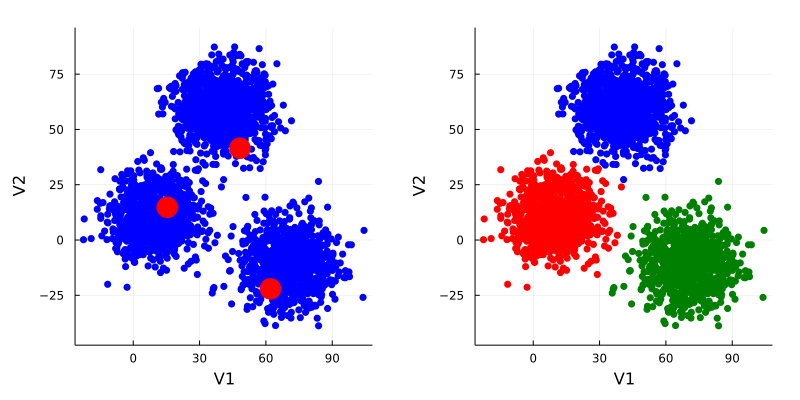

In [143]:
fix_seed!()

K = 3
df = RDatasets.dataset("cluster", "xclara")
data = Matrix(df)'

seeds = initseeds(:rand, data, K)
xclaraKmeans = kmeans(data, K, init = seeds)

println("Number of clusters: ", nclusters(xclaraKmeans))
println("Counts of clusters: ", counts(xclaraKmeans))

df.Group  = assignments(xclaraKmeans)

p1 = scatter(df[:, :V1], df[:, :V2], c=:blue, msw=0)
     scatter!(df[seeds, :V1], df[seeds, :V2], markersize=12, c=:red, msw=0)

p2 = scatter( df[df.Group .== 1, :V1], df[df.Group .== 1, :V2], c=:blue, msw=0)
     scatter!( df[df.Group .== 2, :V1], df[df.Group .== 2, :V2], c=:red, msw=0)
     scatter!( df[df.Group .== 3, :V1], df[df.Group .== 3, :V2], c=:green, msw=0)

plot(p1,p2,legend=:none,ratio=:equal, size=(800,400), xlabel="V1", ylabel="V2", margin = 5mm)

#### The MNIST digits dataset

In [144]:
using MLDatasets

In [145]:
train_data = MLDatasets.MNIST(split=:train)[:]

imgs = train_data[1]
@show typeof(imgs)
@show size(imgs)

labels = train_data[2]
@show typeof(labels);

typeof(imgs) = Array{Float32, 3}
size(imgs) = (28, 28, 60000)
typeof(labels) = Vector{Int64}


In [146]:
test_data = MLDatasets.MNIST(split=:test)[:]
test_imgs = test_data[1]
test_labels = test_data[2]
@show size(test_imgs);

size(test_imgs) = (28, 28, 10000)


In [147]:
n_train, n_test = length(labels), length(test_labels)

(60000, 10000)

In [148]:
some_digits = [Gray.(train_data[1][:,:,k]') for k in 1:5];

In [149]:
some_digits[3]

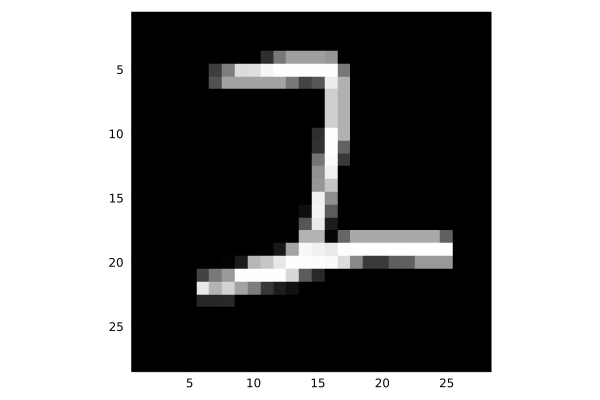

In [150]:
heatmap(some_digits[3]',yflip=true)

size(X) = (60000, 784)


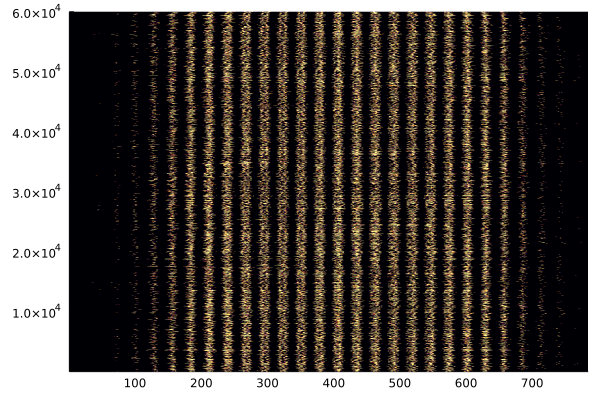

In [151]:
X = vcat([vec(imgs[:,:,k])' for k in 1:last(size(imgs))]...)
@show size(X)
heatmap(X,legend=false)

#### Principal component analysis (PCA)

In [152]:
pca = fit(PCA, X'; maxoutdim=2)
M = projection(pca)

args = (ms=0.8, msw=0, xlims=(-5,12.5), ylims=(-7.5,7.5),
            legend = :topright, xlabel="PC 1", ylabel="PC 2")

function compareDigits(dA,dB)
    xA = X[labels .== dA, :]'
    xB = X[labels .== dB, :]'
    zA, zB = M'*xA, M'*xB
    
    scatter(zA[1,:], zA[2,:], c=:red, label="Digit $(dA)"; args...)
    scatter!(zB[1,:], zB[2,:], c=:blue, label="Digit $(dB)"; args...)
end

plots = []
for k in 1:5
    push!(plots,compareDigits(2k-2,2k-1))
end
plot(plots...,size = (800, 500), margin = 5mm)

[home](#home)

## The End -- הסוף

I hope you enjoyed the tutorial.

Many more of these types of examples + statistical background are at [statisticswithjulia.org](https://statisticswithjulia.org/).